In [1]:
import pandas as pd

# Load the dataset (adjust the path to your local file if necessary)
df = pd.read_csv(r'C:\machine_learning files\telecom_customer_churn.csv')  # Update the path if needed

# Display the initial shape and a preview of the data
print("Initial data shape:", df.shape)
print(df.head())

# Display basic information about the dataset
print(df.info())

# Check for missing values in each column
print("Missing values per column:")
print(df.isnull().sum())

# Summary statistics for numerical features
print(df.describe())



Initial data shape: (7043, 38)
  Customer ID  Gender  Age Married  Number of Dependents          City  \
0  0002-ORFBO  Female   37     Yes                     0  Frazier Park   
1  0003-MKNFE    Male   46      No                     0      Glendale   
2  0004-TLHLJ    Male   50      No                     0    Costa Mesa   
3  0011-IGKFF    Male   78     Yes                     0      Martinez   
4  0013-EXCHZ  Female   75     Yes                     0     Camarillo   

   Zip Code   Latitude   Longitude  Number of Referrals  ...   Payment Method  \
0     93225  34.827662 -118.999073                    2  ...      Credit Card   
1     91206  34.162515 -118.203869                    0  ...      Credit Card   
2     92627  33.645672 -117.922613                    0  ...  Bank Withdrawal   
3     94553  38.014457 -122.115432                    1  ...  Bank Withdrawal   
4     93010  34.227846 -119.079903                    3  ...      Credit Card   

  Monthly Charge Total Charges  Total

In [2]:
# Handling missing values

# Replace missing values in categorical columns with 'Not Subscribed'
categorical_columns_with_missing = ['Offer', 'Multiple Lines', 'Internet Type', 'Online Security', 'Online Backup', 'Device Protection Plan', 
                                    'Premium Tech Support', 'Streaming TV', 'Streaming Movies', 'Streaming Music', 'Unlimited Data']
for column in categorical_columns_with_missing:
    df[column] = df[column].fillna('Not Subscribed')

# Fill missing values in numerical columns with the median
numerical_columns_with_missing = ['Avg Monthly Long Distance Charges', 'Avg Monthly GB Download']
for column in numerical_columns_with_missing:
    df[column] = df[column].fillna(df[column].median())

# Drop 'Customer ID' as it is not useful for analysis
df = df.drop('Customer ID', axis=1)

# Fix invalid negative values in 'Monthly Charge'
df['Monthly Charge'] = df['Monthly Charge'].apply(lambda x: x if x >= 0 else df['Monthly Charge'].median())

# Remove any rows where 'Churn Category' is missing, since we need this for our target variable
df = df.dropna(subset=['Churn Category'])

# Check the cleaned data
print("Cleaned data shape:", df.shape)
print(df.isnull().sum())  # Ensure there are no remaining missing values



Cleaned data shape: (1869, 37)
Gender                               0
Age                                  0
Married                              0
Number of Dependents                 0
City                                 0
Zip Code                             0
Latitude                             0
Longitude                            0
Number of Referrals                  0
Tenure in Months                     0
Offer                                0
Phone Service                        0
Avg Monthly Long Distance Charges    0
Multiple Lines                       0
Internet Service                     0
Internet Type                        0
Avg Monthly GB Download              0
Online Security                      0
Online Backup                        0
Device Protection Plan               0
Premium Tech Support                 0
Streaming TV                         0
Streaming Movies                     0
Streaming Music                      0
Unlimited Data                   

In [3]:
import pandas as pd

# Load the data
df = pd.read_csv(r'C:\machine_learning files\telecom_customer_churn.csv')  # Update the path as necessary

# Display the initial state of the dataframe
print("Initial data shape:", df.shape)
print(df.head())

# Handling missing values for categorical data by replacing with 'Not Subscribed' or a similar placeholder
categorical_columns_with_missing = ['Internet Type', 'Online Security', 'Online Backup', 'Device Protection Plan', 'Premium Tech Support', 'Streaming TV', 'Streaming Movies', 'Streaming Music']
for column in categorical_columns_with_missing:
    df[column] = df[column].fillna('Not Subscribed')  # Corrected assignment

# For binary features like Phone Service, replace missing with the mode (most frequent value)
binary_columns = ['Phone Service', 'Multiple Lines', 'Internet Service']
for column in binary_columns:
    df[column] = df[column].fillna(df[column].mode()[0])  # Corrected assignment

# Handling numerical columns - impute missing values with the median
numerical_columns_with_missing = ['Avg Monthly Long Distance Charges', 'Avg Monthly GB Download']
for column in numerical_columns_with_missing:
    df[column] = df[column].fillna(df[column].median())  # Corrected assignment

# Drop 'Customer ID' as it is not useful for analysis
df = df.drop('Customer ID', axis=1)

# Remove any rows where 'Churn Category' is missing if it's necessary for your analysis
df = df.dropna(subset=['Churn Category'])

# Display the final state of the dataframe
print("Cleaned data shape:", df.shape)
print(df.head())

# Save the cleaned data
df.to_csv("cleaned_telecom_customer_churn.csv", index=False)



Initial data shape: (7043, 38)
  Customer ID  Gender  Age Married  Number of Dependents          City  \
0  0002-ORFBO  Female   37     Yes                     0  Frazier Park   
1  0003-MKNFE    Male   46      No                     0      Glendale   
2  0004-TLHLJ    Male   50      No                     0    Costa Mesa   
3  0011-IGKFF    Male   78     Yes                     0      Martinez   
4  0013-EXCHZ  Female   75     Yes                     0     Camarillo   

   Zip Code   Latitude   Longitude  Number of Referrals  ...   Payment Method  \
0     93225  34.827662 -118.999073                    2  ...      Credit Card   
1     91206  34.162515 -118.203869                    0  ...      Credit Card   
2     92627  33.645672 -117.922613                    0  ...  Bank Withdrawal   
3     94553  38.014457 -122.115432                    1  ...  Bank Withdrawal   
4     93010  34.227846 -119.079903                    3  ...      Credit Card   

  Monthly Charge Total Charges  Total

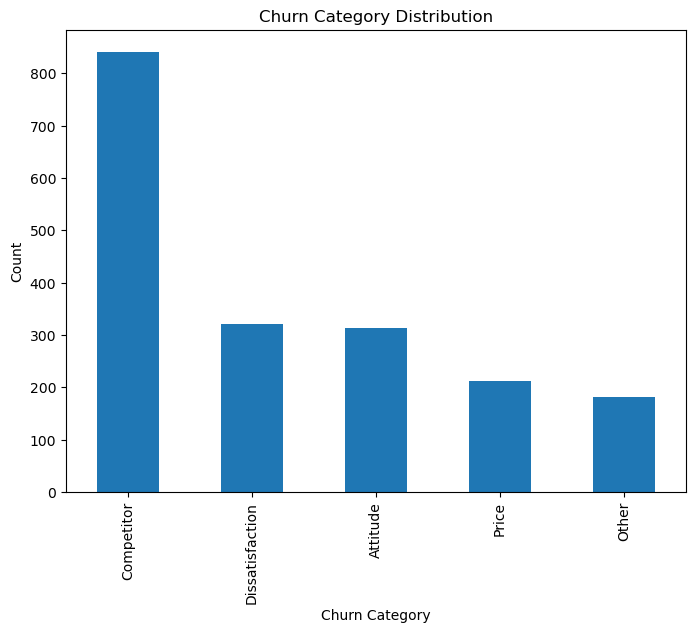

In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

# Churn Category distribution
plt.figure(figsize=(8, 6))
df['Churn Category'].value_counts().plot(kind='bar')
plt.title('Churn Category Distribution')
plt.ylabel('Count')
plt.show()





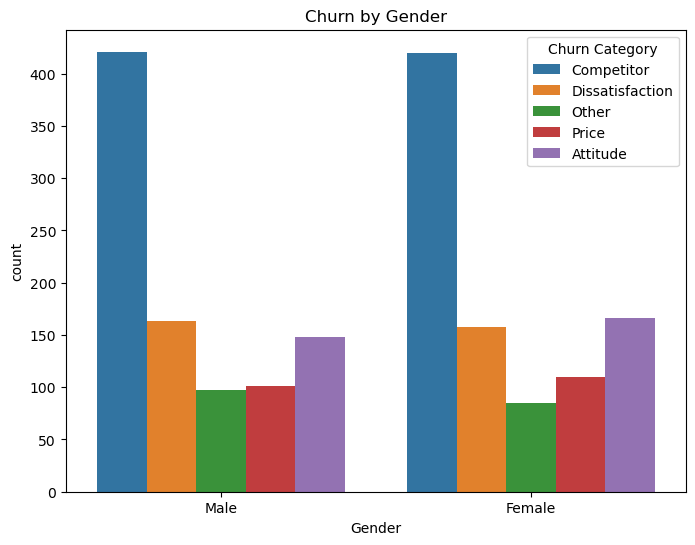

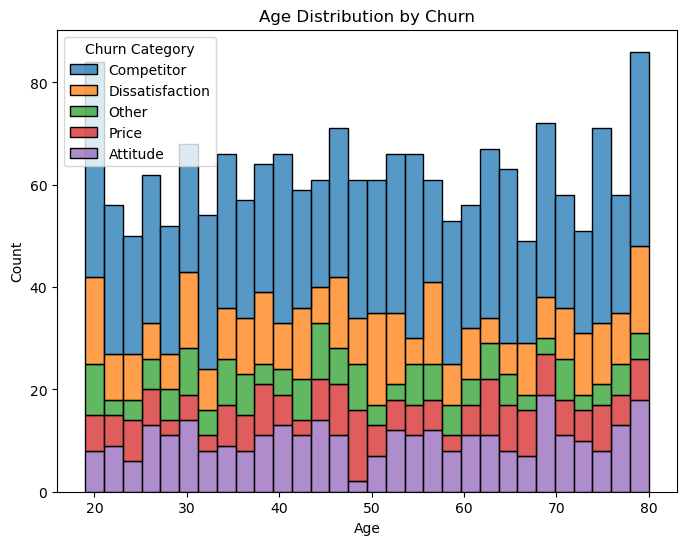

In [5]:
# Gender distribution by churn
plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='Gender', hue='Churn Category')
plt.title('Churn by Gender')
plt.show()

# Distribution of Age by churn category
plt.figure(figsize=(8, 6))
sns.histplot(data=df, x='Age', hue='Churn Category', multiple='stack', bins=30)
plt.title('Age Distribution by Churn')
plt.show()




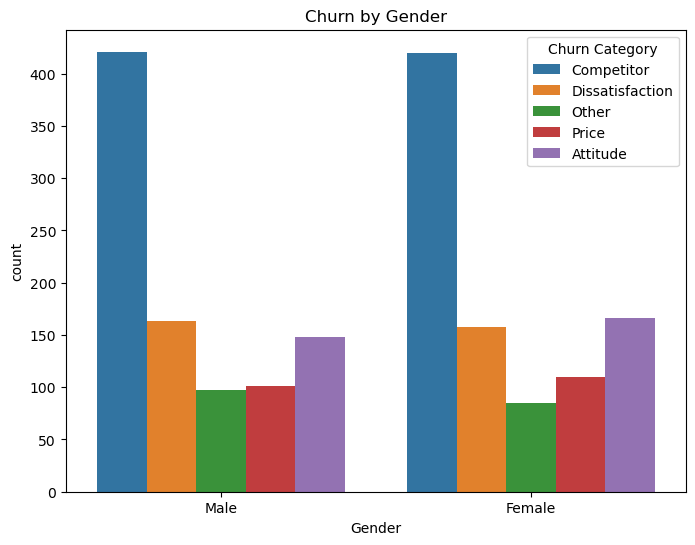

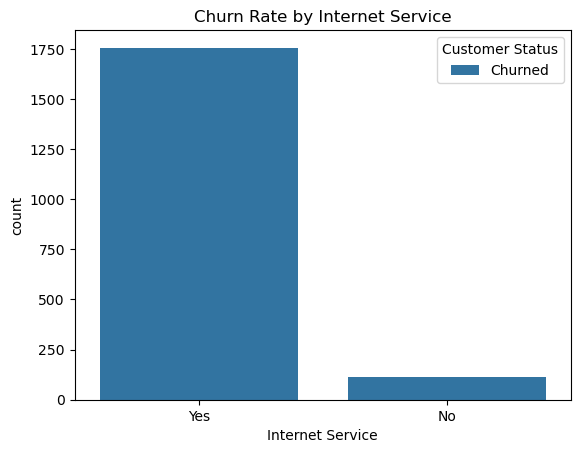

In [22]:
# Gender distribution by churn
plt.figure(figsize=(8, 6))
sns.countplot(data=df, x='Gender', hue='Churn Category')
plt.title('Churn by Gender')
plt.show()

# Churn rate by Internet Service
sns.countplot(data=df, x='Internet Service', hue='Customer Status')
plt.title('Churn Rate by Internet Service')
plt.show()


In [5]:

# One-Hot Encoding for categorical columns
df_encoded = pd.get_dummies(df, drop_first=True)

# Display the first few rows of the encoded dataframe to verify the encoding
print(df_encoded.head())

# Check the shape of the encoded dataframe to see how many columns we have now
print("Encoded data shape:", df_encoded.shape)





    Age  Number of Dependents  Zip Code   Latitude   Longitude  \
2    50                     0     92627  33.645672 -117.922613   
3    78                     0     94553  38.014457 -122.115432   
4    75                     0     93010  34.227846 -119.079903   
18   79                     0     94015  37.680844 -122.481310   
19   67                     0     95037  37.161544 -121.649371   

    Number of Referrals  Tenure in Months  Avg Monthly Long Distance Charges  \
2                     0                 4                              33.65   
3                     1                13                              27.82   
4                     3                 3                               7.38   
18                    0                45                              10.67   
19                    0                 1                              25.69   

    Avg Monthly GB Download  Monthly Charge  ...  \
2                      30.0            73.9  ...   
3                 

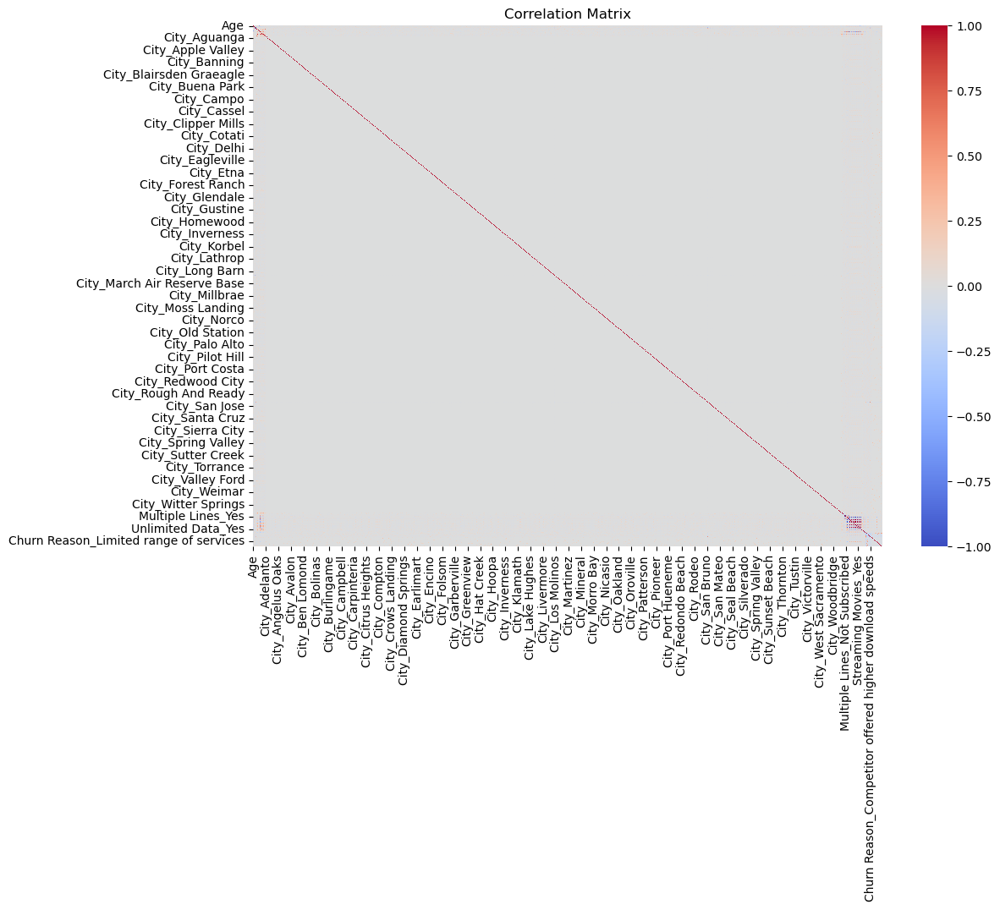

In [6]:
# Correlation heatmap for the encoded dataset
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the correlation matrix
correlation_matrix = df_encoded.corr()

# Plotting the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=False, fmt='.2f', cmap='coolwarm')
plt.title('Correlation Matrix')
plt.show()



In [7]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt

# Scaling the data for better clustering performance
scaler = StandardScaler()
data_scaled = scaler.fit_transform(df_encoded)




C:\Users\kpolice\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(
C:\Users\kpolice\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(
C:\Users\kpolice\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(
C:\Users\kpolice\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak o

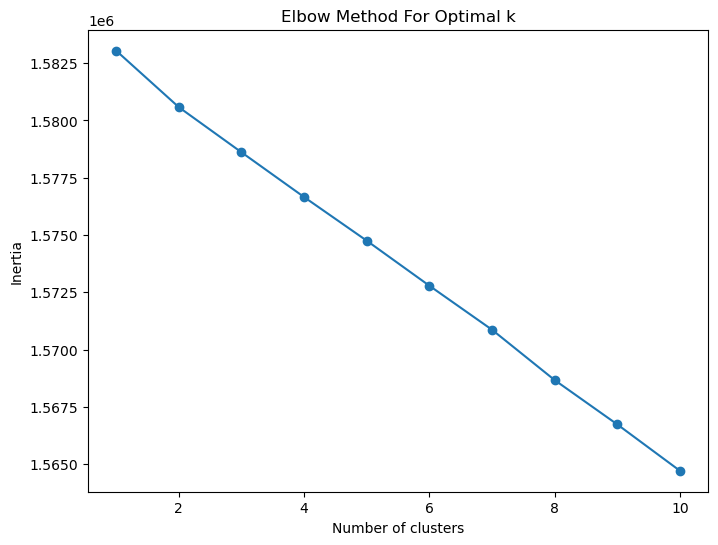

In [14]:
# Elbow method to find the optimal number of clusters
sse = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(data_scaled)
    sse.append(kmeans.inertia_)

# Plotting the elbow curve
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), sse, marker='o')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.title('Elbow Method For Optimal k')
plt.show()





In [8]:
# After determining the optimal k from the elbow curve
# Let's assume 4 clusters based on the elbow plot (adjust based on your findings)
optimal_k = 4  # Update this based on the elbow curve result

# Applying K-means with optimal number of clusters
kmeans = KMeans(n_clusters=optimal_k, random_state=42)
cluster_labels = kmeans.fit_predict(data_scaled)

# Adding the cluster labels to the original dataframe
df_encoded['Cluster'] = cluster_labels

# Inspect the first few rows to check the clusters
print(df_encoded.head())


    Age  Number of Dependents  Zip Code   Latitude   Longitude  \
2    50                     0     92627  33.645672 -117.922613   
3    78                     0     94553  38.014457 -122.115432   
4    75                     0     93010  34.227846 -119.079903   
18   79                     0     94015  37.680844 -122.481310   
19   67                     0     95037  37.161544 -121.649371   

    Number of Referrals  Tenure in Months  Avg Monthly Long Distance Charges  \
2                     0                 4                              33.65   
3                     1                13                              27.82   
4                     3                 3                               7.38   
18                    0                45                              10.67   
19                    0                 1                              25.69   

    Avg Monthly GB Download  Monthly Charge  ...  \
2                      30.0            73.9  ...   
3                 

C:\Users\kpolice\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=8.
  warnings.warn(


In [9]:
import seaborn as sns
import matplotlib.pyplot as plt

# Statistical Summary for Numerical Features
cluster_summary = df_encoded.groupby('Cluster').agg(['mean', 'std'])
print(cluster_summary)






               Age            Number of Dependents                Zip Code  \
              mean        std                 mean       std          mean   
Cluster                                                                      
0        60.000000        NaN             0.000000       NaN  94030.000000   
1        49.755770  17.602330             0.118626  0.550746  93436.369834   
2        24.500000   4.949747             0.000000  0.000000  95014.000000   
3        50.666667  17.616280             0.000000  0.000000  91802.333333   

                       Latitude             Longitude            ...  \
                 std       mean       std        mean       std  ...   
Cluster                                                          ...   
0                NaN  37.601248       NaN -122.403099       NaN  ...   
1        1824.203606  36.027717  2.499445 -119.668884  2.149959  ...   
2           0.000000  37.306612  0.000000 -122.080621  0.000000  ...   
3           1.154701 

In [10]:
# Statistical Summary for Categorical Features
for column in df_encoded.select_dtypes(include=['object', 'bool']).columns:
    mode_df = df_encoded.groupby('Cluster')[column].agg(lambda x: x.value_counts().index[0])
    print(f'Mode for {column} by cluster:\n{mode_df}')




Mode for Gender_Male by cluster:
Cluster
0    False
1    False
2    False
3     True
Name: Gender_Male, dtype: bool
Mode for Married_Yes by cluster:
Cluster
0     True
1    False
2     True
3     True
Name: Married_Yes, dtype: bool
Mode for City_Adelanto by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Adelanto, dtype: bool
Mode for City_Adin by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Adin, dtype: bool
Mode for City_Agoura Hills by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Agoura Hills, dtype: bool
Mode for City_Aguanga by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Aguanga, dtype: bool
Mode for City_Ahwahnee by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Ahwahnee, dtype: bool
Mode for City_Albany by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Albany, dtype: bool
Mode for City_Alderpoint by cluster:
Cluster
0    Fals

Mode for Gender_Male by cluster:
Cluster
0    False
1    False
2    False
3     True
Name: Gender_Male, dtype: bool
Mode for Married_Yes by cluster:
Cluster
0     True
1    False
2     True
3     True
Name: Married_Yes, dtype: bool
Mode for City_Adelanto by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Adelanto, dtype: bool
Mode for City_Adin by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Adin, dtype: bool
Mode for City_Agoura Hills by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Agoura Hills, dtype: bool
Mode for City_Aguanga by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Aguanga, dtype: bool
Mode for City_Ahwahnee by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Ahwahnee, dtype: bool
Mode for City_Albany by cluster:
Cluster
0    False
1    False
2    False
3    False
Name: City_Albany, dtype: bool
Mode for City_Alderpoint by cluster:
Cluster
0    Fals

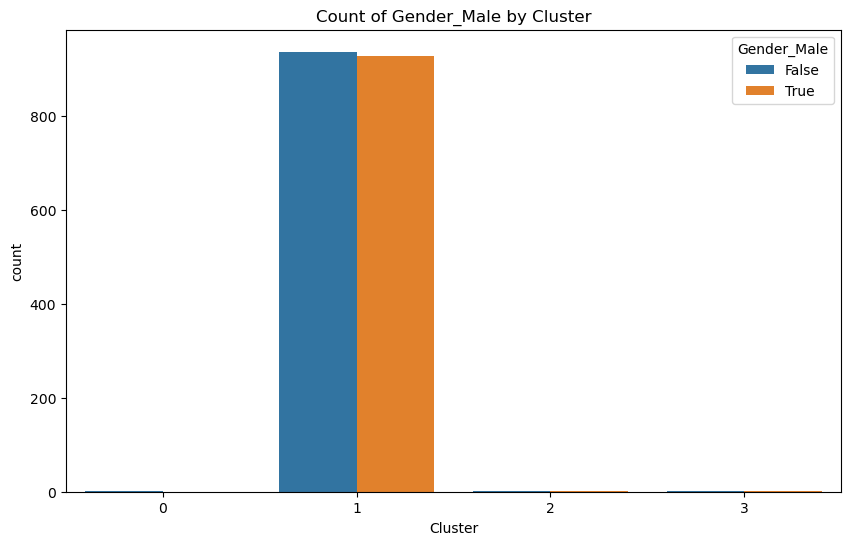

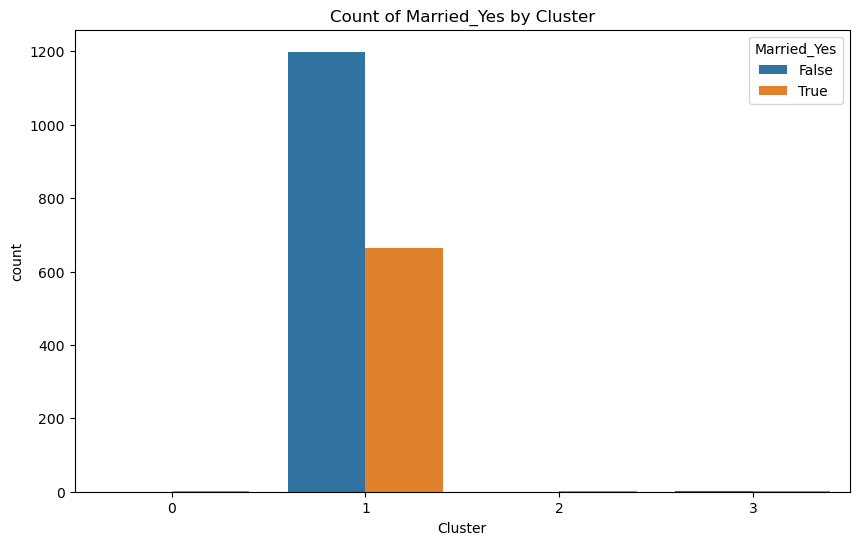

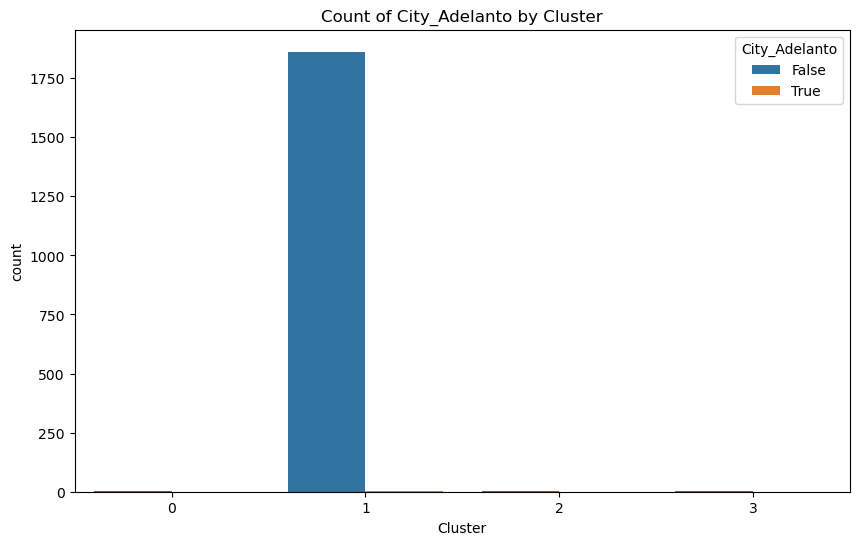

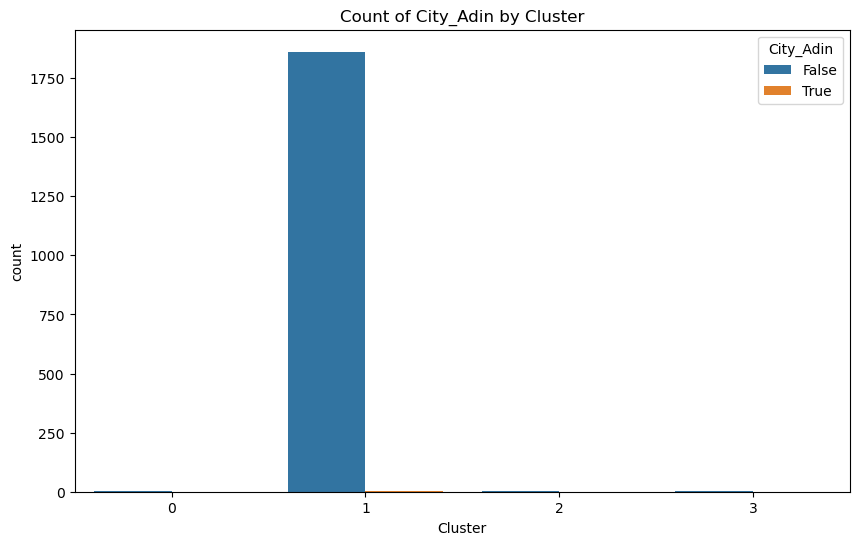

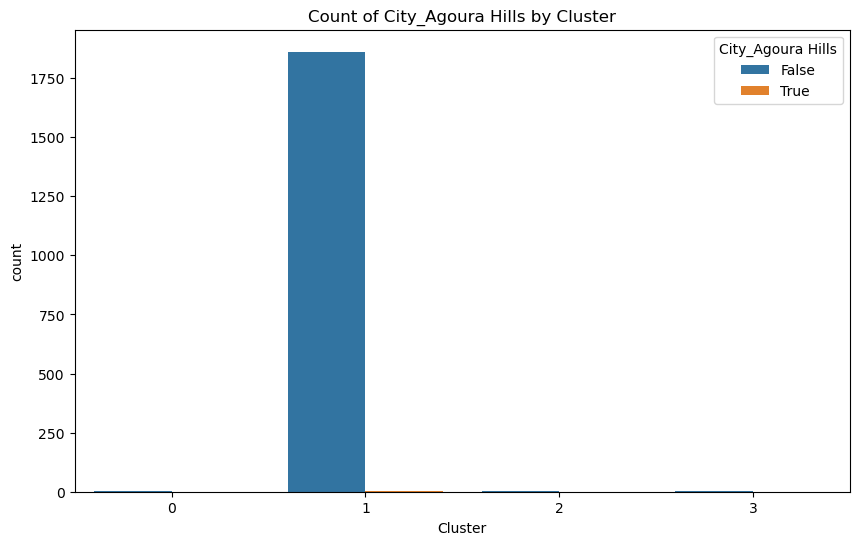

...

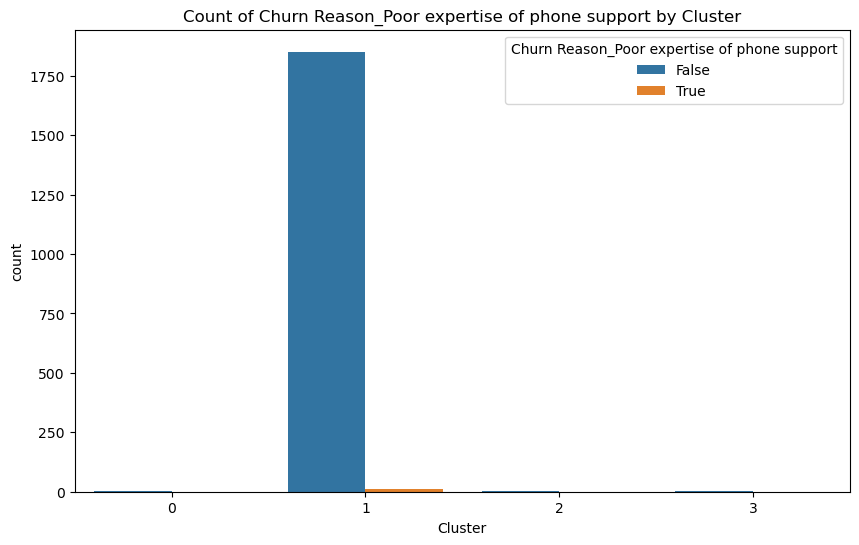

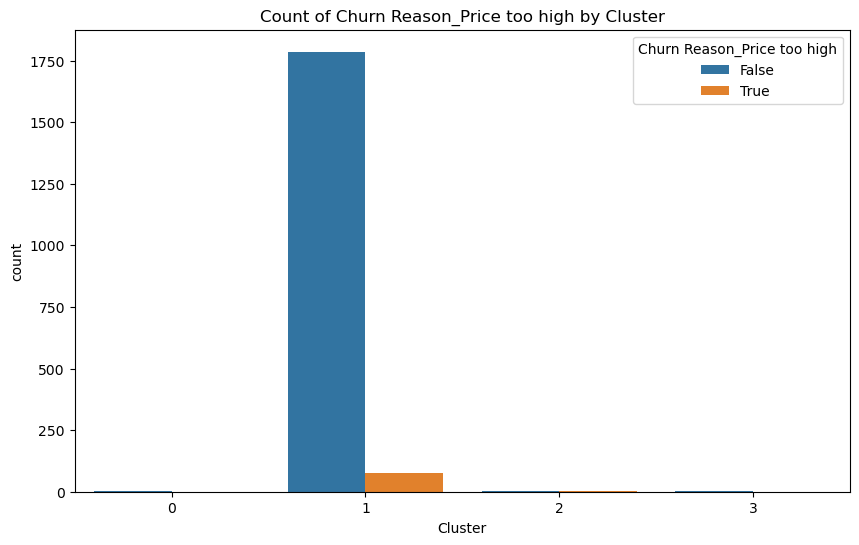

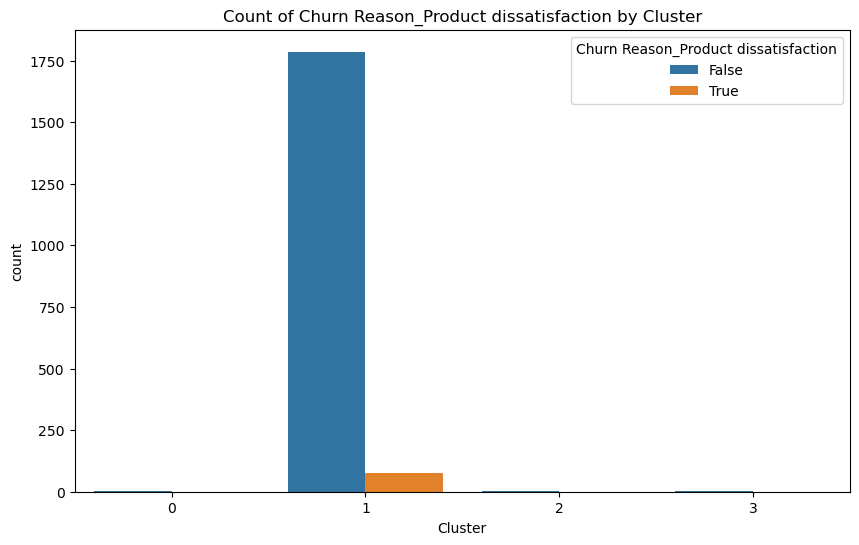

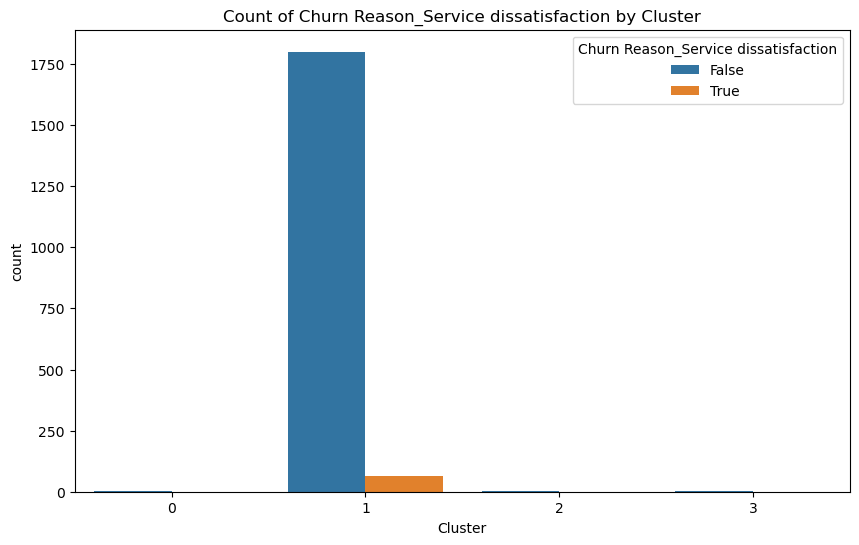

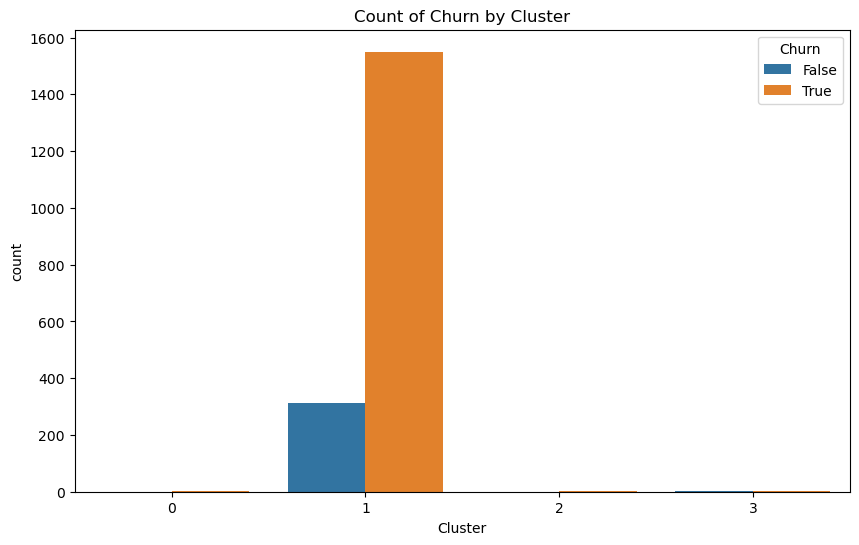

In [21]:
# Statistical Summary for Categorical Features
for column in df_encoded.select_dtypes(include=['object', 'bool']).columns:
    mode_df = df_encoded.groupby('Cluster')[column].agg(lambda x: x.value_counts().index[0])
    print(f'Mode for {column} by cluster:\n{mode_df}')

# Visualization of categorical data
for column in df_encoded.select_dtypes(include=['object', 'bool']).columns:
    plt.figure(figsize=(10, 6))
    sns.countplot(x='Cluster', hue=column, data=df_encoded)
    plt.title(f'Count of {column} by Cluster')
    plt.show()





In [12]:


# Check the column names to identify which one represents the target ('Customer Status' or 'Churn')
print(df_encoded.columns)


Index(['Age', 'Number of Dependents', 'Zip Code', 'Latitude', 'Longitude',
       'Number of Referrals', 'Tenure in Months',
       'Avg Monthly Long Distance Charges', 'Avg Monthly GB Download',
       'Monthly Charge',
       ...
       'Churn Reason_Limited range of services',
       'Churn Reason_Long distance charges', 'Churn Reason_Moved',
       'Churn Reason_Network reliability',
       'Churn Reason_Poor expertise of online support',
       'Churn Reason_Poor expertise of phone support',
       'Churn Reason_Price too high', 'Churn Reason_Product dissatisfaction',
       'Churn Reason_Service dissatisfaction', 'Cluster'],
      dtype='object', length=850)


In [13]:

# Check if there is any column containing 'Churn'
churn_columns = [col for col in df_encoded.columns if 'Churn' in col]
print(churn_columns)



['Churn Category_Competitor', 'Churn Category_Dissatisfaction', 'Churn Category_Other', 'Churn Category_Price', 'Churn Reason_Attitude of support person', 'Churn Reason_Competitor had better devices', 'Churn Reason_Competitor made better offer', 'Churn Reason_Competitor offered higher download speeds', 'Churn Reason_Competitor offered more data', 'Churn Reason_Deceased', "Churn Reason_Don't know", 'Churn Reason_Extra data charges', 'Churn Reason_Lack of affordable download/upload speed', 'Churn Reason_Lack of self-service on Website', 'Churn Reason_Limited range of services', 'Churn Reason_Long distance charges', 'Churn Reason_Moved', 'Churn Reason_Network reliability', 'Churn Reason_Poor expertise of online support', 'Churn Reason_Poor expertise of phone support', 'Churn Reason_Price too high', 'Churn Reason_Product dissatisfaction', 'Churn Reason_Service dissatisfaction']


In [15]:
# Create a binary 'Churn' column: 1 for churned, 0 for not churned
df_encoded['Churn'] = df_encoded[['Churn Category_Competitor', 'Churn Category_Dissatisfaction', 
                                  'Churn Category_Other', 'Churn Category_Price']].max(axis=1)

# Check the distribution of the 'Churn' column to ensure it's correctly created
print(df_encoded['Churn'].value_counts())


Churn
True     1555
False     314
Name: count, dtype: int64


In [16]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix

# Define feature set (X) and target (y)
X = df_encoded.drop(columns=['Churn'])  # Dropping the target column
y = df_encoded['Churn'].astype(int)  # Target column

# Split the data into training and test sets (80-20 split)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize the Logistic Regression model
model = LogisticRegression(max_iter=1000)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
print(confusion_matrix(y_test, y_pred))
print(classification_report(y_test, y_pred))



[[ 17  39]
 [  2 316]]
              precision    recall  f1-score   support

           0       0.89      0.30      0.45        56
           1       0.89      0.99      0.94       318

    accuracy                           0.89       374
   macro avg       0.89      0.65      0.70       374
weighted avg       0.89      0.89      0.87       374



C:\Users\kpolice\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [18]:
# Define X and y
X_encoded = df_encoded.drop(columns=['Churn'])  # Drop 'Churn' from the features
y = df_encoded['Churn']  # Target variable

# Split the data into training and testing sets (80-20 split)
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

# Apply SMOTE to balance the classes in the training set
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Train the Logistic Regression model
model = LogisticRegression(max_iter=1000)
model.fit(X_train_resampled, y_train_resampled)

# Make predictions
predictions = model.predict(X_test)

# Evaluate the model
print(confusion_matrix(y_test, predictions))
print(classification_report(y_test, predictions))




[[ 41  15]
 [ 25 293]]
              precision    recall  f1-score   support

       False       0.62      0.73      0.67        56
        True       0.95      0.92      0.94       318

    accuracy                           0.89       374
   macro avg       0.79      0.83      0.80       374
weighted avg       0.90      0.89      0.90       374



C:\Users\kpolice\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [19]:

from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix

# Assuming df_encoded is your preprocessed DataFrame and 'Churn' is the target variable
X = df_encoded.drop('Churn', axis=1)
y = df_encoded['Churn']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train the Decision Tree classifier
decision_tree = DecisionTreeClassifier(random_state=42)
decision_tree.fit(X_train, y_train)

# Make predictions
y_pred_dt = decision_tree.predict(X_test)

# Evaluate the model
print(confusion_matrix(y_test, y_pred_dt))
print(classification_report(y_test, y_pred_dt))


[[ 56   0]
 [  0 318]]
              precision    recall  f1-score   support

       False       1.00      1.00      1.00        56
        True       1.00      1.00      1.00       318

    accuracy                           1.00       374
   macro avg       1.00      1.00      1.00       374
weighted avg       1.00      1.00      1.00       374



In [20]:

from sklearn.ensemble import RandomForestClassifier

# Initialize and train the Random Forest classifier
random_forest = RandomForestClassifier(n_estimators=100, random_state=42)
random_forest.fit(X_train, y_train)

# Make predictions
y_pred_rf = random_forest.predict(X_test)

# Evaluate the model
print(confusion_matrix(y_test, y_pred_rf))
print(classification_report(y_test, y_pred_rf))


[[ 47   9]
 [  0 318]]
              precision    recall  f1-score   support

       False       1.00      0.84      0.91        56
        True       0.97      1.00      0.99       318

    accuracy                           0.98       374
   macro avg       0.99      0.92      0.95       374
weighted avg       0.98      0.98      0.98       374

